# Analysis on Gun Violemce incidents around public places




In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import folium
from shapely.geometry import Point
import utm
import pyproj
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter(action='ignore', category=FutureWarning)

In [ ]:
m = folium.Map(location=[42.3601, -71.0589], zoom_start=12)
# Read the police districts shapefile
police_districts = gpd.read_file('locationsshapefiles/Police_Districts/Police_Districts.shp')
selected_districts = ['C11', 'B2', 'B3']

# Create a GeoJSON layer for the police districts
folium.GeoJson(police_districts, style_function=lambda x: {'color': 'green' if x['properties']['DISTRICT'] in selected_districts else 'blue', 'weight': 2}).add_to(m)

m

In [ ]:
police_stations = pd.read_csv('locationscsv/Boston_Police_Stations.csv')

selected_stations = police_stations[police_stations['NAME'].isin(['District C-11 Police Station', 'District B-2 Police Station', 'District B-3 Police Station'])]

for _, station in selected_stations.iterrows():
    folium.Marker(
        location=[station['CENTROIDY'], station['CENTROIDX']],
        icon=folium.Icon(color='blue'),
        popup=station['NAME']
    ).add_to(m)

m


In [ ]:
selected_police_districts_gdf = police_districts[police_districts['DISTRICT'].isin(selected_districts)]

def point_within_selected_districts(lat, lon, selected_police_districts_gdf):
    point = Point(lon, lat)
    return selected_police_districts_gdf['geometry'].apply(lambda x: x.contains(point) or x.touches(point)).any()


In [ ]:
# Read the cannabis data
cannabis_data = pd.read_csv("locationscsv/Cannabis_Registry.csv")

# Filter the cannabis_data to include only the rows with locations inside or on the green border
cannabis_data['within_selected_districts'] = cannabis_data.apply(lambda row: point_within_selected_districts(row['y'], row['x'], selected_police_districts_gdf), axis=1)

cannabis_data = cannabis_data[cannabis_data['within_selected_districts']]

# Add purple markers for each filtered cannabis location
for index, row in cannabis_data.iterrows():
    folium.Marker(
        location=[row['y'], row['x']],
        icon=folium.Icon(color='purple'),
        popup=row['Main_Entity_Name']
    ).add_to(m)

# Display the map
m


In [ ]:
# from geopy.geocoders import Nominatim
# from geopy.extra.rate_limiter import RateLimiter
# import pandas as pd
# import warnings
# warnings.filterwarnings("ignore", category=FutureWarning)
# warnings.filterwarnings("ignore", category=DeprecationWarning)


# # Read the CSV file
# liquor_data = pd.read_csv("locationscsv/liquor.csv")

# # Drop rows if any of the specified columns have a missing value or zero
# columns_to_check = ['address', 'city', 'state', 'zip', 'gpsx', 'gpsy']
# liquorstore_data = liquor_data.dropna(subset=columns_to_check)
# liquorstore_data = liquorstore_data[~liquorstore_data[columns_to_check].eq(0).any(axis=1)]
# columns_to_drop = ['license_num', 'historicallicensenum', 'status', 'license_type', 'issued', 'expires',                    'dba_name', 'comments', 'location_comments', 'opening', 'closing', 'patronsout', 'capacity',                    'applicant', 'manager', 'day_phone', 'evening_phone']
# liquorstore_data = liquorstore_data.drop(columns=columns_to_drop)


# # Create a geolocator object with a timeout value of 10 seconds
# geolocator = Nominatim(user_agent="myGeocoder", timeout=10)

# # Define the number of retries and delay time between retries
# num_retries = 3
# retry_delay_seconds = 1

# # Create a rate limiter to avoid reaching API limits
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)

# # Initialize empty lists to store latitude and longitude values
# latitude = []
# longitude = []

# # Loop through the dataset to get latitude and longitude from address, city, state, and zip
# for index, row in liquorstore_data.iterrows():
#     address = f"{row['address']}, {row['city']}, {row['state']}, {row['zip']}"
#     for i in range(num_retries):
#         try:
#             location = geocode(address)
#             if location:
#                 latitude.append(location.latitude)
#                 longitude.append(location.longitude)
#             else:
#                 latitude.append(None)
#                 longitude.append(None)
#             break  # exit the retry loop if the API call is successful
#         except (socket.timeout, requests.exceptions.ReadTimeout, GeocoderTimedOut):
#             if i < num_retries - 1:
#                 time.sleep(retry_delay_seconds)
#                 continue
#             else:
#                 latitude.append(None)
#                 longitude.append(None)

# # Add the latitude and longitude lists to the dataset
# liquorstore_data['latitude'] = latitude
# liquorstore_data['longitude'] = longitude

# # Save the updated dataset with latitude and longitude columns
# liquorstore_data.to_csv("locationscsv/liquor_with_lat_lon.csv", index=False)

# # Display the dataset
# liquorstore_data.head()


In [ ]:
liquorstore_data = pd.read_csv("locationscsv/liquor_with_lat_lon.csv")

# Drop rows where both latitude and longitude are null
liquorstore_data.dropna(subset=['latitude', 'longitude'], inplace=True)

# Save the updated dataset with dropped null values
liquorstore_data.to_csv("locationscsv/liquor_with_lat_lon.csv", index=False)

# Display the dataset
liquorstore_data.head()

,business_name,address,city,state,zip,gpsx,gpsy,latitude,longitude
0,"MIDA East Boston, LLC",65- Lewis St,East Boston,MA,2128,779829.589386,2.959337e+06,42.367661,-71.042332
1,"Midnight Morning, LLC",14B Birch ST,Roslindale,MA,2131,756294.698115,2.929750e+06,42.286883,-71.130003
2,"Oasis Enterprize Group, Inc.",33- Hancock ST,Dorchester,MA,2125,773590.049372,2.939883e+06,42.314296,-71.065836
3,Neighborhood Guy LLC,619- Tremont ST,Boston,MA,2118,771234.079130,2.950214e+06,42.342752,-71.074377
4,"Mike & Patty's JP, LLC",388- Centre ST,Jamaica Plain,MA,2130,761723.925238,2.942515e+06,42.321271,-71.110173


In [ ]:
# Load the dataset with latitude and longitude columns
liquorstore_data = pd.read_csv("locationscsv/liquor_with_lat_lon.csv")

# Drop rows with missing latitude or longitude values
liquorstore_data = liquorstore_data.dropna(subset=['latitude', 'longitude'])
liquorstore_data['within_selected_districts'] = liquorstore_data.apply(lambda row: point_within_selected_districts(row['latitude'], row['longitude'],selected_police_districts_gdf), axis=1)
liquorstore_data = liquorstore_data[liquorstore_data['within_selected_districts']]

for index, row in liquorstore_data .iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        icon=folium.Icon(color='orange')
    ).add_to(m)

# Display the map
m

In [ ]:
# Load the dataset with latitude and longitude columns
hospitals_data = pd.read_csv("locationscsv/Hospitals.csv")

# Drop rows with missing latitude or longitude values
hospitals_data = hospitals_data.dropna(subset=['Latitude', 'Longitude'])
hospitals_data['within_selected_districts'] = hospitals_data.apply(lambda row: point_within_selected_districts(row['Latitude'], row['Longitude'],selected_police_districts_gdf), axis=1)
hospitals_data = hospitals_data[hospitals_data['within_selected_districts']]

for index, row in hospitals_data .iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        icon=folium.Icon(color='white')
    ).add_to(m)

# Display the map
m

In [ ]:
bus_stops_gdf = gpd.read_file("locationsshapefiles/mbtabus/MBTABUSSTOPS_PT.shp")

# Convert the CRS of the bus stops data to WGS84
bus_stops_gdf = bus_stops_gdf.to_crs(epsg=4326)

# Extract the coordinates of the bus stops
bus_stops_gdf['lon'] = bus_stops_gdf['geometry'].x
bus_stops_gdf['lat'] = bus_stops_gdf['geometry'].y

bus_data = bus_stops_gdf
bus_data = bus_data.dropna(subset=['lat', 'lon'])
bus_data['within_selected_districts'] = bus_data.apply(lambda row: point_within_selected_districts(row['lat'], row['lon'], selected_police_districts_gdf), axis=1)
bus_data = bus_data[bus_data['within_selected_districts']]

for index, row in bus_data.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        icon=folium.Icon(color='green')
    ).add_to(m)
m


In [ ]:
train_stops_gdf = gpd.read_file("locationsshapefiles/trains/TRAINS_NODE.shp")

# Convert the CRS of the bus stops data to WGS84
train_stops_gdf = train_stops_gdf.to_crs(epsg=4326)

# Extract the coordinates of the bus stops
train_stops_gdf['lon'] = train_stops_gdf['geometry'].x
train_stops_gdf['lat'] = train_stops_gdf['geometry'].y

trains_data = train_stops_gdf
trains_data = trains_data.dropna(subset=['lat', 'lon'])
trains_data['within_selected_districts'] = trains_data.apply(lambda row: point_within_selected_districts(row['lat'], row['lon'], selected_police_districts_gdf), axis=1)
trains_data = trains_data[trains_data['within_selected_districts']]

for index, row in trains_data.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        icon=folium.Icon(color='gray')
    ).add_to(m)
m



In [ ]:
# Read the open spaces data
open_spaces_gdf = gpd.read_file("locationsshapefiles/Open_Space/Open_Space.shp")

# Convert the CRS of the open spaces data to WGS84
open_spaces_gdf = open_spaces_gdf.to_crs(epsg=4326)

# Extract the centroids of the geometries
open_spaces_gdf['centroid'] = open_spaces_gdf['geometry'].centroid

# Extract the coordinates of the centroids
open_spaces_gdf['lon'] = open_spaces_gdf['centroid'].x
open_spaces_gdf['lat'] = open_spaces_gdf['centroid'].y

open_spaces_data = open_spaces_gdf
open_spaces_data = open_spaces_data.dropna(subset=['lat', 'lon'])

# You may need to update the 'point_within_selected_districts' function and 'selected_police_districts_gdf' variable
open_spaces_data['within_selected_districts'] = open_spaces_data.apply(lambda row: point_within_selected_districts(row['lat'], row['lon'], selected_police_districts_gdf), axis=1)
open_spaces_data = open_spaces_data[open_spaces_data['within_selected_districts']]

# Add markers to the map
for index, row in open_spaces_data.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        icon=folium.Icon(color='black')
    ).add_to(m)

# Display the map
m



In [ ]:
schools_gdf = gpd.read_file("locationsshapefiles/trains/TRAINS_NODE.shp")

# Convert the CRS of the bus stops data to WGS84
schools_gdf = schools_gdf.to_crs(epsg=4326)

# Extract the coordinates of the bus stops
schools_gdf['lon'] = schools_gdf['geometry'].x
schools_gdf['lat'] = schools_gdf['geometry'].y

schools_data = schools_gdf
schools_data = schools_data.dropna(subset=['lat', 'lon'])
schools_data['within_selected_districts'] = schools_data.apply(lambda row: point_within_selected_districts(row['lat'], row['lon'], selected_police_districts_gdf), axis=1)
schools_data = schools_data[schools_data['within_selected_districts']]

for index, row in schools_data.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        icon=folium.Icon(color='beige')
    ).add_to(m)
m




In [ ]:
worship_gdf = gpd.read_file("locationsshapefiles/Places_of_Worship/Places_of_Worship.shp")

# Convert the CRS of the bus stops data to WGS84
worship_gdf = worship_gdf.to_crs(epsg=4326)

# Extract the coordinates of the bus stops
worship_gdf['lon'] = worship_gdf['geometry'].x
worship_gdf['lat'] = worship_gdf['geometry'].y

worship_data = worship_gdf
worship_data = worship_data.dropna(subset=['lat', 'lon'])
worship_data['within_selected_districts'] = worship_data.apply(lambda row: point_within_selected_districts(row['lat'], row['lon'], selected_police_districts_gdf), axis=1)
worship_data = worship_data[worship_data['within_selected_districts']]

for index, row in worship_data.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        icon=folium.Icon(color='pink')
    ).add_to(m)
m

In [ ]:
df_2015= pd.read_csv("crime_reports/cir_2015.csv")
df_2016= pd.read_csv("crime_reports/cir_2016.csv")
df_2017= pd.read_csv("crime_reports/cir_2017.csv")
df_2018= pd.read_csv("crime_reports/cir_2018.csv")
df_2019= pd.read_csv("crime_reports/cir_2019.csv")
df_2020= pd.read_csv("crime_reports/cir_2020.csv")
df_2021= pd.read_csv("crime_reports/cir_2021.csv")
df_2022= pd.read_csv("crime_reports/cir_2022.csv")
df_2023= pd.read_csv("crime_reports/cir_2023.csv")

In [ ]:
#combining the datasets of different years
frames = [df_2015,df_2016,df_2017,df_2018,df_2019,df_2020,df_2021,df_2022,df_2023]
df = pd.concat(frames)

In [ ]:
df.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,I172040657,2629,Harassment,HARASSMENT,C11,397,NaN,2015-06-15 00:00:00,2015,6,Monday,0,Part Two,MELBOURNE ST,42.291093,-71.065945,"(42.29109287, -71.06594539)"
1,I182061268,3201,Property Lost,PROPERTY - LOST,NaN,,NaN,2015-06-15 00:00:00,2015,6,Monday,0,Part Three,BERNARD,NaN,NaN,NaN
2,I162013546,3201,Property Lost,PROPERTY - LOST,B3,433,NaN,2015-06-15 00:00:00,2015,6,Monday,0,Part Three,NORFOLK ST,42.283634,-71.082813,"(42.28363434, -71.08281320)"
3,I152051083,3115,Investigate Person,INVESTIGATE PERSON,A7,20,NaN,2015-06-15 00:00:00,2015,6,Monday,0,Part Three,PARIS ST,42.377023,-71.032247,"(42.37702319, -71.03224730)"
4,I152059178,2647,Other,THREATS TO DO BODILY HARM,C11,359,NaN,2015-06-15 00:00:00,2015,6,Monday,0,Part Two,WASHINGTON ST,42.293606,-71.071887,"(42.29360585, -71.07188650)"


In [ ]:
df_new = df[['INCIDENT_NUMBER', 'OFFENSE_CODE','OFFENSE_DESCRIPTION', 'DISTRICT', 'YEAR','Lat','Long']].copy()

In [ ]:
df_new.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_DESCRIPTION,DISTRICT,YEAR,Lat,Long
0,I172040657,2629,HARASSMENT,C11,2015,42.291093,-71.065945
1,I182061268,3201,PROPERTY - LOST,NaN,2015,NaN,NaN
2,I162013546,3201,PROPERTY - LOST,B3,2015,42.283634,-71.082813
3,I152051083,3115,INVESTIGATE PERSON,A7,2015,42.377023,-71.032247
4,I152059178,2647,THREATS TO DO BODILY HARM,C11,2015,42.293606,-71.071887


In [ ]:
df_new = df_new.dropna(subset=['DISTRICT','Lat','Long'])

In [ ]:
# Filter the dataframe for the specified offense codes and police districts
offense_codes = [1501, 3119, 1510, 3016, 3203, 1503, 1502]
selected_districts = ['B2', 'B3', 'C11']
filtered_df = df_new[df_new['OFFENSE_CODE'].isin(offense_codes) & df_new['DISTRICT'].isin(selected_districts)]

# Drop rows with missing latitude or longitude values
filtered_df = filtered_df.dropna(subset=['Lat', 'Long'])

# Filter the filtered_df to include only the rows with locations inside or on the green border
filtered_df['within_selected_districts'] = filtered_df.apply(lambda row: point_within_selected_districts(row['Lat'], row['Long'],selected_police_districts_gdf), axis=1)
filtered_df = filtered_df[filtered_df['within_selected_districts']]

# Add red markers for each filtered offense location
for index, row in filtered_df.iterrows():
    folium.Marker(
        location=[row['Lat'], row['Long']],
        icon=folium.Icon(color='red'),
        popup=row['INCIDENT_NUMBER']
    ).add_to(m)

# Display the map
m


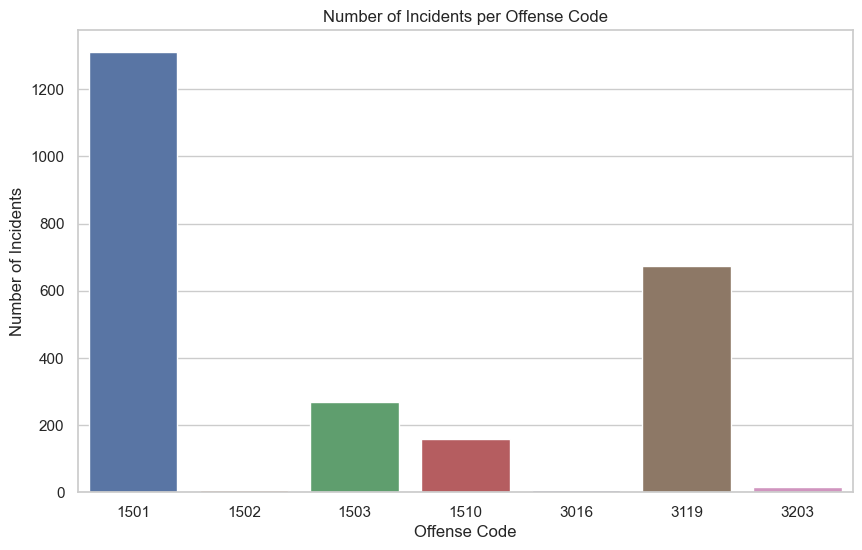

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="whitegrid")

# Calculate the count of each offense code
offense_counts = filtered_df['OFFENSE_CODE'].value_counts().reset_index()
offense_counts.columns = ['Offense Code', 'Count']


# Create the bar graph
plt.figure(figsize=(10, 6))
bar_plot = sns.barplot(x='Offense Code', y='Count', data=offense_counts)
plt.xlabel('Offense Code')
plt.ylabel('Number of Incidents')
plt.title('Number of Incidents per Offense Code')
plt.show()


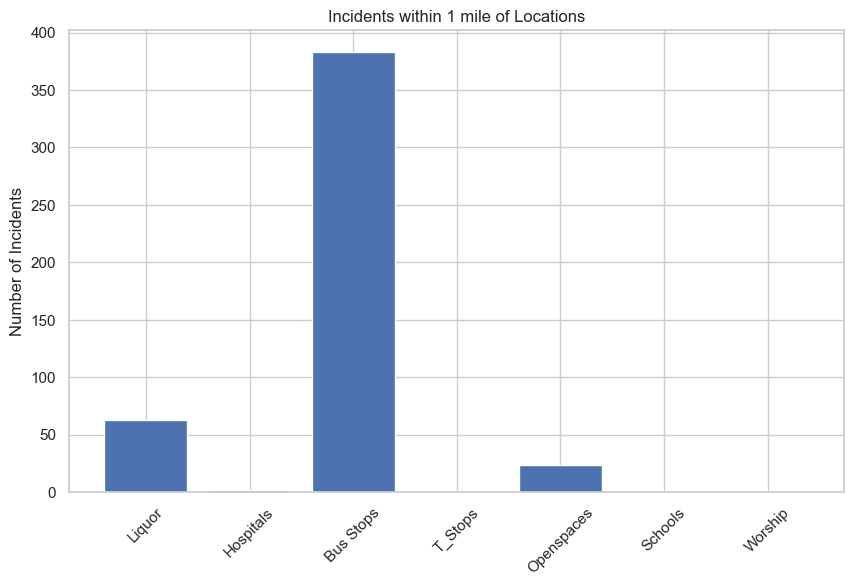

In [ ]:
import math
def haversine_distance(coord1, coord2):
    lat1, lon1 = coord1
    lat2, lon2 = coord2
    R = 6371  # Earth's radius in kilometers

    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)

    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad

    a = (math.sin(dlat / 2) ** 2) + math.cos(lat1_rad) * math.cos(lat2_rad) * (math.sin(dlon / 2) ** 2)
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))

    return R * c / 1.609

def count_incidents_within_radius(locations, incidents, lat_col='latitude', lon_col='longitude', radius_miles=1):
    radius_degrees = radius_miles / 69.0
    counts = []

    for _, location in locations.iterrows():
        location_point = (location[lat_col], location[lon_col])
        count = 0

        for _, incident in incidents.iterrows():
            incident_point = (incident['Lat'], incident['Long'])
            distance = haversine_distance(location_point, incident_point)
            if distance <= radius_degrees:
                count += 1

        counts.append(count)

    return counts


liquorstore_counts = count_incidents_within_radius(liquorstore_data, filtered_df)
#cannabis_counts = count_incidents_within_radius(cannabis_data, filtered_df, lat_col='y', lon_col='x')
#selected_stations_counts = count_incidents_within_radius(selected_stations, filtered_df, lat_col='CENTROIDY', lon_col='CENTROIDX', radius_miles=0.5)
hospital_counts = count_incidents_within_radius(hospitals_data, filtered_df, lat_col='Latitude', lon_col='Longitude')
busstop_counts = count_incidents_within_radius(bus_data, filtered_df, lat_col='lat', lon_col='lon')
trainstop_counts = count_incidents_within_radius(trains_data, filtered_df, lat_col='lat', lon_col='lon')
openspaces_counts = count_incidents_within_radius(open_spaces_data, filtered_df, lat_col='lat', lon_col='lon')
schools_counts = count_incidents_within_radius(schools_data, filtered_df, lat_col='lat', lon_col='lon')
worship_counts = count_incidents_within_radius(worship_data, filtered_df, lat_col='lat', lon_col='lon')
# Plotting the bar graph
labels = ['Liquor','Hospitals','Bus Stops','T_Stops','Openspaces','Schools','Worship']
total_counts = [sum(liquorstore_counts), sum(hospital_counts), sum(busstop_counts),sum(trainstop_counts),sum(openspaces_counts),sum(schools_counts),sum(worship_counts)]
plt.figure(figsize=(10, 6))

plt.bar(labels, total_counts)
plt.ylabel('Number of Incidents')
plt.title('Incidents within 1 mile of Locations')
plt.xticks(rotation=45)
plt.show()



In [ ]:
print(f"Liquor Stores: {sum(liquorstore_counts)}")
print(f"Hospitals: {sum(hospital_counts)}")
print(f"Bus Stops: {sum(busstop_counts)}")
print(f"T-Stops: {sum(trainstop_counts)}")
print(f"Open Spaces: {sum(openspaces_counts)}")
print(f"Schools: {sum(schools_counts)}")
print(f"Places of Worship: {sum(worship_counts)}")

Liquor Stores: 63
Hospitals: 2
Bus Stops: 383
T-Stops: 0
Open Spaces: 24
Schools: 0
Places of Worship: 0


## Further Analysis on District 4 itself

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import sns as sns

df_2015= pd.read_csv("crime_reports/cir_2015.csv")
df_2016= pd.read_csv("crime_reports/cir_2016.csv")
df_2017= pd.read_csv("crime_reports/cir_2017.csv")
df_2018= pd.read_csv("crime_reports/cir_2018.csv")
df_2019= pd.read_csv("crime_reports/cir_2019.csv")
df_2020= pd.read_csv("crime_reports/cir_2020.csv")
df_2021= pd.read_csv("crime_reports/cir_2021.csv")
df_2022= pd.read_csv("crime_reports/cir_2022.csv")
df_2023= pd.read_csv("crime_reports/cir_2023.csv")

frames = [df_2015,df_2016,df_2017,df_2018,df_2019,df_2020,df_2021,df_2022,df_2023]

df = pd.concat(frames)


/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3221: DtypeWarning: Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Previous code to preprocess district 4
city_council = gpd.read_file('City_Council_Districts_-_Effective_for_the_2023_Municipal_Election/City_Council_Districts_-_Effective_for_the_2023_Municipal_Election.shp')
BPD = gpd.read_file('Police_Districts/Police_Districts.shp')

shooting_incident = df[df['SHOOTING'] == 1]

district_4 = city_council[city_council['FID'] == 4]

from turfpy.measurement import boolean_point_in_polygon
from geojson import Point, Polygon, Feature

shooting_incident['point'] = [Point(xy) for xy in zip(shooting_incident.Long, shooting_incident.Lat)] 

district_4.iloc[0]['geometry'].geom_type
geometry = gpd.GeoSeries([district_4.iloc[0]['geometry']]).__geo_interface__
features = geometry['features']
polygon = Polygon(features[0]['geometry']['coordinates'])

shooting_incident['district_4'] = [boolean_point_in_polygon(shooting_incident.iloc[i]['point'], polygon) for i in range(len(shooting_incident))]
shooting_incident_4 = shooting_incident[shooting_incident['district_4'] == True]


/var/folders/f9/whc2b54d75zgf67cr18q46x80000gn/T/ipykernel_46247/916490144.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shooting_incident['point'] = [Point(xy) for xy in zip(shooting_incident.Long, shooting_incident.Lat)]
/var/folders/f9/whc2b54d75zgf67cr18q46x80000gn/T/ipykernel_46247/916490144.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shooting_incident['district_4'] = [boolean_point_in_polygon(shooting_incident.iloc[i]['point'], polygon) for i in range(len(shooting_incident))]


,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location,point,district_4
770,192000890,3114,NaN,INVESTIGATE PROPERTY,B3,439,1,2019-01-04 03:50:00,2019,1,Friday,3,NaN,BLUE HILL AVE,42.290561,-71.089260,"(42.29056131, -71.08926032)","{'type': 'Point', 'coordinates': [-71.08926, 4...",True
1255,192001459,3114,NaN,INVESTIGATE PROPERTY,C11,336,1,2019-01-06 03:16:00,2019,1,Sunday,3,NaN,EUNICE ST,42.304738,-71.070258,"(42.30473813, -71.07025782)","{'type': 'Point', 'coordinates': [-71.070258, ...",True
2540,192003016,413,NaN,ASSAULT - AGGRAVATED - BATTERY,C11,344,1,2019-01-11 19:31:00,2019,1,Friday,19,NaN,CORONA ST,42.301462,-71.068960,"(42.30146187, -71.06895964)","{'type': 'Point', 'coordinates': [-71.06896, 4...",True
2605,192003087,2662,NaN,BALLISTICS EVIDENCE/FOUND,C11,362,1,2019-01-12 02:31:00,2019,1,Saturday,2,NaN,MOULTRIE ST,42.291285,-71.070339,"(42.29128483, -71.07033894)","{'type': 'Point', 'coordinates': [-71.070339, ...",True
2988,192003523,2662,NaN,BALLISTICS EVIDENCE/FOUND,B3,429,1,2019-01-13 22:07:00,2019,1,Sunday,22,NaN,LUCERNE ST,42.284727,-71.089220,"(42.28472661, -71.08921977)","{'type': 'Point', 'coordinates': [-71.08922, 4...",True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7213,232010222,3114,NaN,INVESTIGATE PROPERTY,B3,,1,2023-02-07 20:55:00+00,2023,2,Tuesday,20,NaN,GREENOCK ST,42.290424,-71.090491,"(42.29042449676464, -71.09049092442505)","{'type': 'Point', 'coordinates': [-71.090491, ...",True
7253,232010259,3114,NaN,INVESTIGATE PROPERTY,B3,,1,2023-02-08 02:04:00+00,2023,2,Wednesday,2,NaN,BLUE HILL AVE,42.288633,-71.089904,"(42.28863337036608, -71.08990387801343)","{'type': 'Point', 'coordinates': [-71.089904, ...",True
8032,232011364,3114,NaN,INVESTIGATE PROPERTY,B3,,1,2023-02-11 17:57:00+00,2023,2,Saturday,17,NaN,WILLOWWOOD ST,42.285190,-71.086366,"(42.28518955028397, -71.08636593667929)","{'type': 'Point', 'coordinates': [-71.086366, ...",True
8202,232011624,2662,NaN,BALLISTICS EVIDENCE/FOUND,B3,,1,2023-02-12 19:48:00+00,2023,2,Sunday,19,NaN,AMERICAN LEGION HWY,42.297088,-71.090955,"(42.2970882854075, -71.09095545824248)","{'type': 'Point', 'coordinates': [-71.090955, ...",True


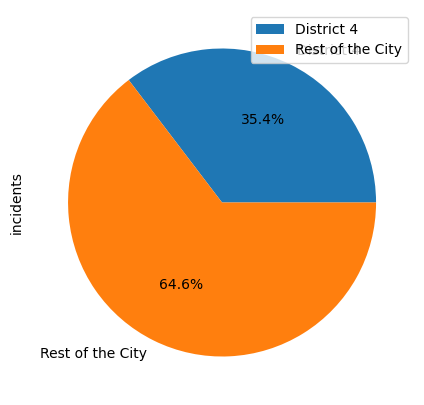

In [ ]:
# Calculate the number of incidents in District 4

num_district_4 = len(shooting_incident_4)

# Calculate the total number of incidents in the city
num_city = len(shooting_incident)

# Calculate the rate of gun violence in District 4
rate_district_4 = num_district_4 / num_city


df = pd.DataFrame({'incidents': [1289, 2356]},
                  index=['District 4', 'Rest of the City'])
plot = df.plot.pie(y='incidents', autopct='%1.1f%%', figsize=(5, 5))

This is th proportion of District 4 incidents comparing with the resest of the city. Given that District 4 by no means adds up to the area or population of 35% of Boston, we can see this incident percentage is really severe.

[Text(0.5, 1.0, 'Number of Incidents by Year'),
 Text(0.5, 0, 'Year'),
 Text(0, 0.5, 'Number of Incidents')]

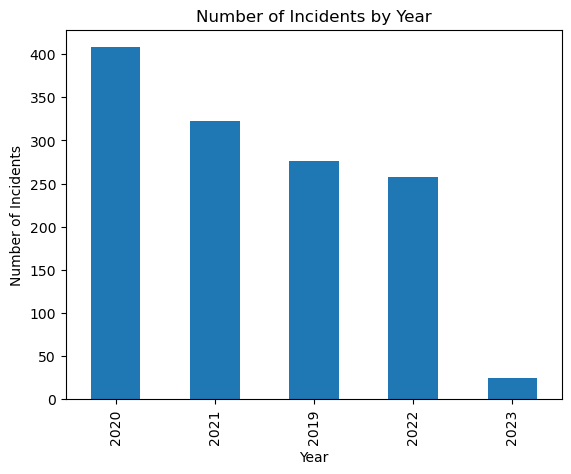

In [ ]:
shooting_incident_4['YEAR'].value_counts().plot(kind = 'bar').set(title='Number of Incidents by Year', xlabel='Year', ylabel='Number of Incidents')

In terms of year, 2020 has in the highest amount of shooting incidents, which can be correlated to the COVID 19 pandemic problems.

[Text(0.5, 1.0, 'Number of Incidents by Date'),
 Text(0.5, 0, 'Date'),
 Text(0, 0.5, 'Number of Incidents')]

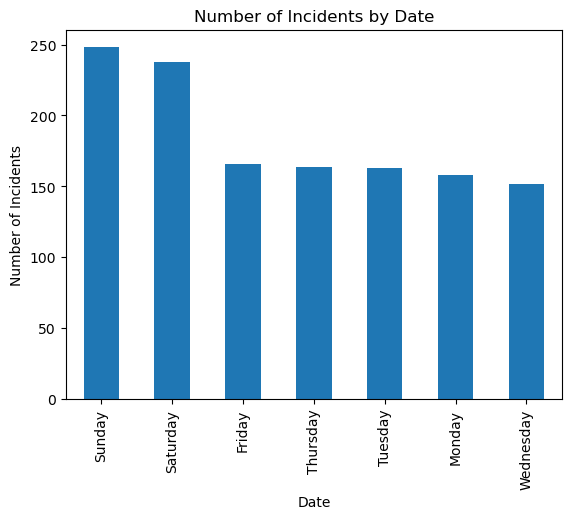

In [ ]:
shooting_incident_4['DAY_OF_WEEK'].value_counts().plot(kind = 'bar').set(title='Number of Incidents by Date', xlabel='Date', ylabel='Number of Incidents')

As we check when do the shooting incidents happen, we can see they mostly happen during weekends. That is probably because people have more free time during weekends so that they are more likely to have conflicts. This can also because people usually have parties during weekends, and the affect of alcohol and drugs might affect people's behaviors.

[Text(0.5, 1.0, 'Number of Incidents by hour'),
 Text(0.5, 0, 'Date'),
 Text(0, 0.5, 'Number of Incidents')]

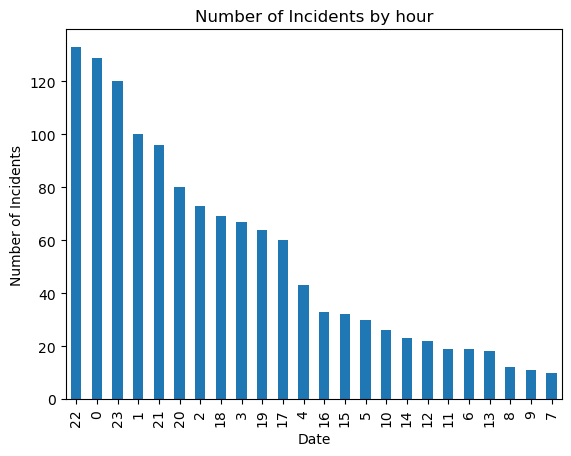

In [ ]:
shooting_incident_4['HOUR'].value_counts().plot(kind = 'bar').set(title='Number of Incidents by hour', xlabel='Date', ylabel='Number of Incidents')

In terms of the hours shooting incidents happen, we can see that's majorly during nights, between 20:00 - 2:00. During that period of a day, the light is dimmer so it's harder to identify the shooter.

Other analysis for the rest of data in terms of police districts:

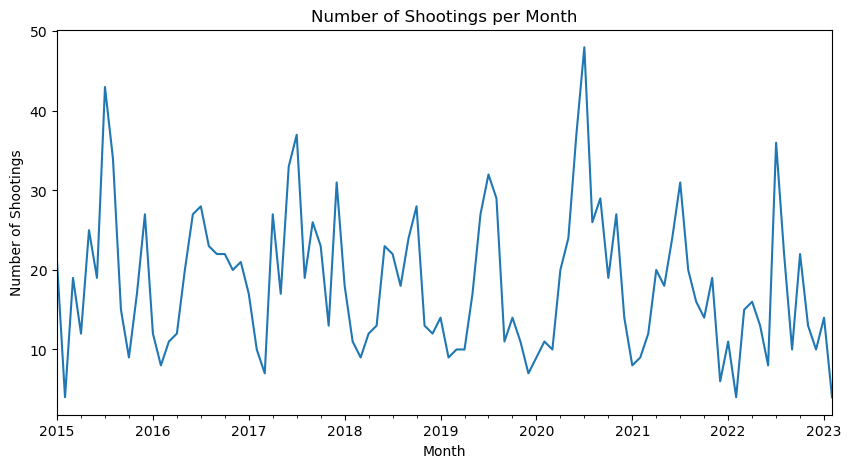

In [ ]:
shootings = pd.read_csv('SHOOTINGS.csv')
shootings['shooting_date'] = pd.to_datetime(shootings['shooting_date'])
shootings.set_index('shooting_date', inplace=True)

monthly_shootings = shootings.resample('M').size()
monthly_shootings.plot(kind='line', figsize=(10, 5))

plt.title('Number of Shootings per Month')
plt.xlabel('Month')
plt.ylabel('Number of Shootings')
plt.show()

This graph displays the number of incidents occurring in each month. we can see from the graph that the highest number of shootings occur in the mid of year, the lowe number of shooting shows at the beginning and end of the year.

/opt/anaconda3/lib/python3.8/site-packages/scipy/__init__.py:138: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.2)
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion} is required for this version of "


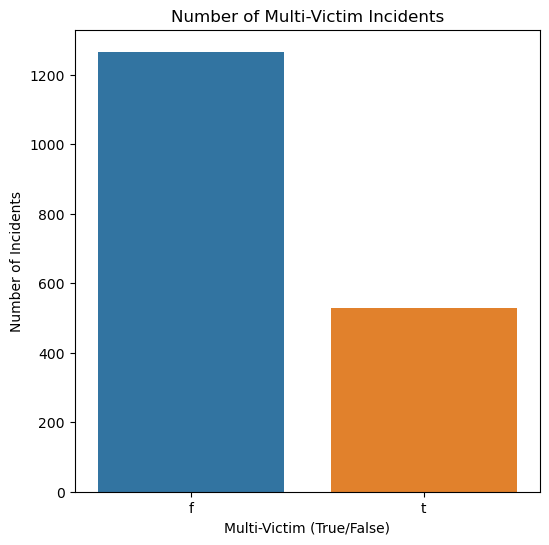

In [ ]:
import seaborn as sns
multi_victim_counts = shootings['multi_victim'].value_counts()
plt.figure(figsize=(6, 6))
sns.barplot(x=multi_victim_counts.index, y=multi_victim_counts.values)
plt.title('Number of Multi-Victim Incidents')
plt.xlabel('Multi-Victim (True/False)')
plt.ylabel('Number of Incidents')
plt.show()

This graph illustrates the number of incidents with multiple victims. we can see most of cases only have single-victim incidents.

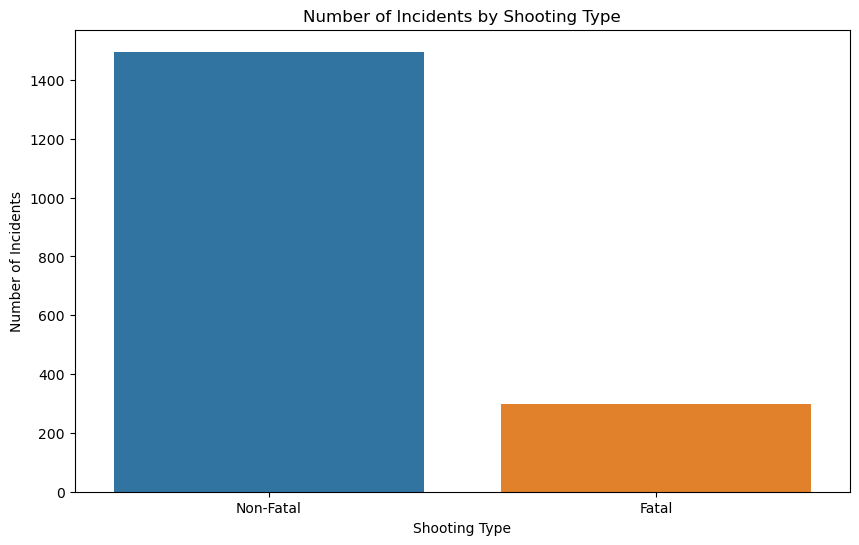

In [ ]:
shooting_type_counts = shootings['shooting_type_v2'].value_counts()
plt.figure(figsize=(10, 6))
sns.barplot(x=shooting_type_counts.index, y=shooting_type_counts.values)
plt.title('Number of Incidents by Shooting Type')
plt.xlabel('Shooting Type')
plt.ylabel('Number of Incidents')
plt.show()

This graph shows the distribution of incidents across different shooting types. most of them are non-fatal.

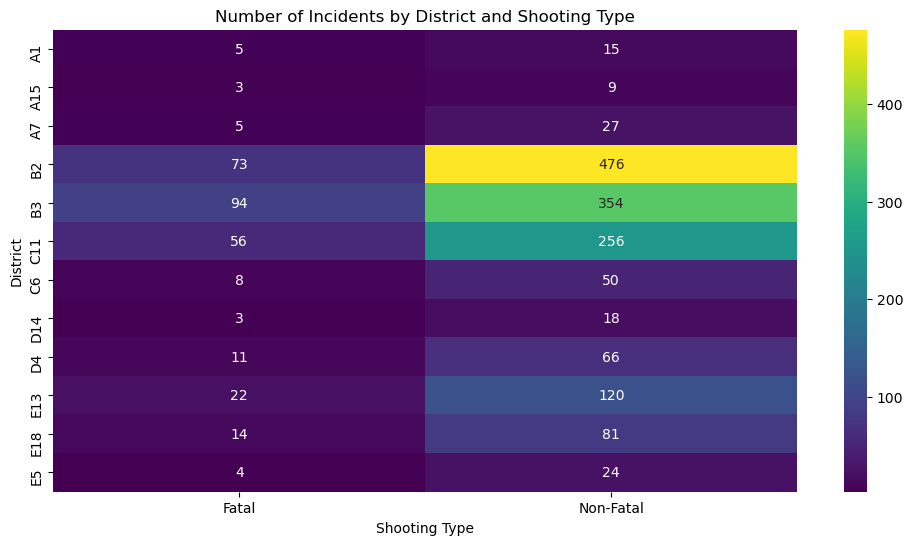

In [ ]:
district_shooting_type = pd.crosstab(shootings['district'], shootings['shooting_type_v2'])
plt.figure(figsize=(12, 6))
sns.heatmap(district_shooting_type, annot=True, fmt='d', cmap='viridis')
plt.title('Number of Incidents by District and Shooting Type')
plt.xlabel('Shooting Type')
plt.ylabel('District')
plt.show()

This heatmap shows the relationship between district and shooting type. It shows the distribution of shooting types across different districts. we can see the most danger area is in B2, B3 and C11, and most of case are non-fatal cases.